In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import os
os.chdir('/content/drive/My Drive/open_ai/color_manga')

In [0]:
from keras import Input
from keras.layers import Dense, Conv2D, UpSampling2D, add, concatenate
from keras.models import Model
from keras.optimizers import RMSprop
from keras.preprocessing.image import load_img, img_to_array, array_to_img
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

Using TensorFlow backend.


In [0]:
TARGET_SIZE = 512

In [0]:
input_tensor = Input(shape=(TARGET_SIZE, TARGET_SIZE, 1))

layer1 = Conv2D(8, (3, 3), activation='relu', padding='same', strides=2)(input_tensor)
layer2 = Conv2D(16, (3, 3), activation='relu', padding='same')(layer1)
layer3 = Conv2D(16, (3, 3), activation='relu', padding='same', strides=2)(layer2)
layer4 = Conv2D(32, (3, 3), activation='relu', padding='same')(layer3)
layer5 = Conv2D(32, (3, 3), activation='relu', padding='same', strides=2)(layer4)
layer6 = Conv2D(32, (3, 3), activation='relu', padding='same')(layer5)
layer7 = Conv2D(64, (3, 3), activation='relu', padding='same', strides=2)(layer6)
layer8 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer7)
layer9 = Conv2D(64, (3, 3), activation='relu', padding='same', strides=2)(layer8)
layer10 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer9)
layer11 = Conv2D(64, (3, 3), activation='relu', padding='same', strides=2)(layer10)
layer12 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer11)
layer13 = Conv2D(64, (3, 3), activation='relu', padding='same', strides=2)(layer12)

layer14 = UpSampling2D((2, 2))(layer13)
layer15 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer14)

layer16 = concatenate([layer15, layer11])
layer17 = UpSampling2D((2, 2))(layer16)
layer18 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer17)

layer19 = concatenate([layer18, layer9])
layer20 = UpSampling2D((2, 2))(layer19)
layer21 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer20)

layer22 = concatenate([layer21, layer7])
layer23 = UpSampling2D((2, 2))(layer22)
layer24 = Conv2D(64, (3, 3), activation='relu', padding='same')(layer23)

layer25 = concatenate([layer24, layer5])
layer26 = UpSampling2D((2, 2))(layer25)
layer27 = Conv2D(32, (3, 3), activation='relu', padding='same')(layer26)

layer28 = concatenate([layer27, layer3])
layer29 = UpSampling2D((2, 2))(layer28)
layer30 = Conv2D(16, (3, 3), activation='relu', padding='same')(layer29)

layer31 = concatenate([layer30, layer1])
layer32 = UpSampling2D((2, 2))(layer31)
layer33 = Conv2D(3, (3,3), activation='tanh', padding='same')(layer32)

model = Model(input_tensor, layer33)
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 8)  80          input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 256, 256, 16) 1168        conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 128, 128, 16) 2320        conv2d_2[0][0]                   
_____________________________________

In [0]:
model.compile(optimizer=RMSprop(lr=3e-5), loss='mse')

In [0]:
input_images_dir = '''line-images'''
label_images_dir = '''colored'''

In [0]:
fnames = os.listdir(input_images_dir)
fpaths = [os.path.join(input_images_dir, fname) for fname in fnames]

In [0]:
def resize_img_to_target_size(img_path, target_size, num_channels):
  color_mode = 'grayscale' if num_channels == 1 else 'rgb'
  img = load_img(img_path, color_mode=color_mode)
  img_array = img_to_array(img)
  width, height, _ = img_array.shape
  max_dim = max(width, height)
  scale_factor = target_size / max_dim
  
  scaled_width, scaled_height = int(width * scale_factor), int(height * scale_factor)
  img = load_img(img_path, target_size=(scaled_width, scaled_height), color_mode=color_mode)
  img_array = img_to_array(img) / 255
  resized_img_array = np.zeros( (target_size, target_size, num_channels) )
  resized_img_array[ (target_size - scaled_width)//2: (target_size - scaled_width)//2 + scaled_width,
                     (target_size - scaled_height)//2: (target_size - scaled_height)//2 + scaled_height, 
                      : ] = img_array
  return resized_img_array

In [0]:
def generator(fnames, batch_size, target_size):
  
  input_fpaths = [os.path.join(input_images_dir, fname) for fname in fnames]
  label_fpaths = [os.path.join(label_images_dir, fname) for fname in fnames]
  
  def get_batches(iterable, n=1):
    l = len(iterable)
    for ndx in range(0, l-n, n):
        yield iterable[ndx:min(ndx + n, l)]
  
  while True:
    for batch in get_batches( list(zip(input_fpaths, label_fpaths)), batch_size ):
      X = np.zeros( (batch_size, target_size, target_size, 1) )
      Y = np.zeros( (batch_size, target_size, target_size, 3) )
      for i, (x_fpath, y_fpath) in enumerate(batch):
        X[i, :, :, :] = resize_img_to_target_size(x_fpath, target_size, 1)
        Y[i, :, :, :] = resize_img_to_target_size(y_fpath, target_size, 3)
      yield X, Y

In [0]:
import random

test_pct = 0.15
val_pct = 0.15

num_files = len(fnames)
num_test_files = int( test_pct * num_files )
num_valid_files = int( val_pct * num_files )
num_train_files = num_files - num_test_files - num_valid_files

random.shuffle(fnames)

test_fnames = fnames[: num_test_files ]
valid_fnames = fnames[num_test_files: num_test_files + num_valid_files]
train_fnames = fnames[num_test_files + num_valid_files: ]

In [0]:
BATCH_SIZE = 16

In [0]:
train_generator = generator(train_fnames, BATCH_SIZE, TARGET_SIZE)
valid_generator = generator(valid_fnames, BATCH_SIZE, TARGET_SIZE)
test_generator = generator(test_fnames, BATCH_SIZE, TARGET_SIZE)

In [0]:
def plot_loss(history_dict):
  x_axis = range( len(history_dict['loss']) )
  plt.scatter(x_axis, history_dict['loss'], label='Training Loss')
  plt.plot(x_axis, history_dict['val_loss'], label='Validation Loss')
  plt.legend()
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.title('Loss Plot')
  plt.show()

In [0]:
def append_to_history(history):
  for lst in history.history:
    if not lst in history_dict:
      history_dict[lst] = history.history[lst]
    else:
      history_dict[lst] += history.history[lst]

In [0]:
import pickle

history_dict = {}
with open('history.pkl', 'wb') as f:
  pickle.dump(history_dict, f)

In [0]:
def preprocess(img_path, num_channels, target_size=TARGET_SIZE):
  img_arr = resize_img_to_target_size(img_path, target_size, num_channels)
  img_arr = img_arr.reshape( (1, ) + img_arr.shape )
  return img_arr

In [0]:
def visualize_model(model, fnames, num_files=1, save_to_disc=False):
  random.shuffle(fnames)
  for fname in fnames[:num_files]:
    input_fpath = os.path.join(input_images_dir, fname)
    label_fpath = os.path.join(label_images_dir, fname)
    
    fig = plt.figure(figsize=(25, 25))
    
    ax = fig.add_subplot(131)
    img_array = preprocess(input_fpath, 1)
    img = array_to_img(img_array[0] * 255)
    plt.imshow(img, cmap='gray')
    plt.title('Input Image')
    
    ax = fig.add_subplot(132)
    img_array = preprocess(label_fpath, 3)
    img = array_to_img(img_array[0] * 255)
    plt.imshow(img)
    plt.title('Label Image')
    
    ax = fig.add_subplot(133)
    img_arr = preprocess(input_fpath, 1)
    img = array_to_img(model.predict(img_arr)[0] * 255)
    plt.imshow(img)
    plt.title('Predicted Image')
    
    if save_to_disc:
        plt.savefig( os.path.join(results_dir, fname) )
    plt.show()
    plt.close(fig)

This is before any training

In [0]:
visualize_model(model, valid_fnames, num_files=5)

Output hidden; open in https://colab.research.google.com to view.

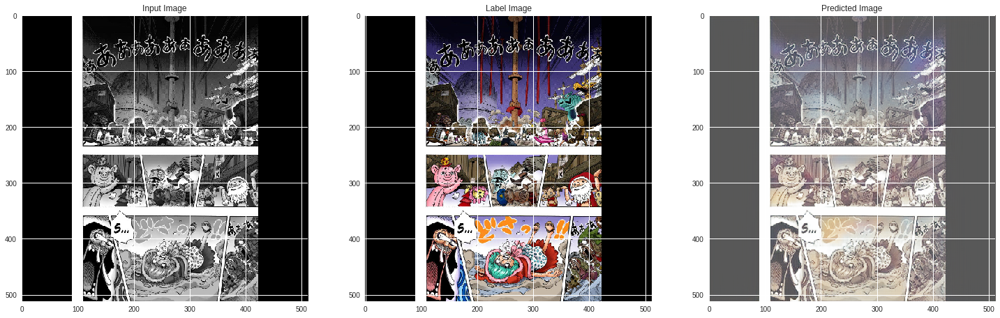

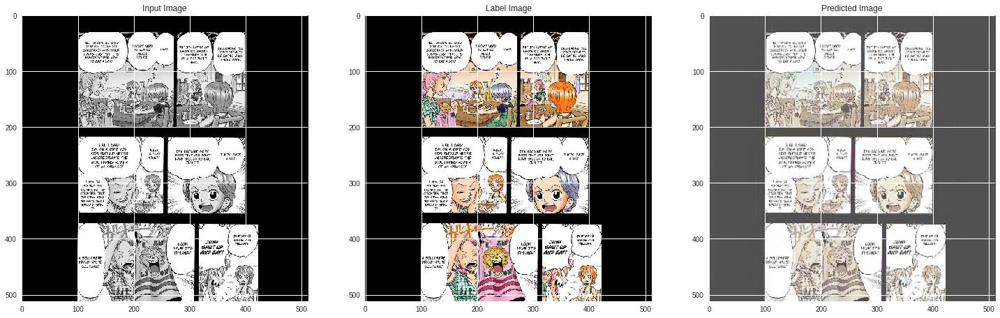

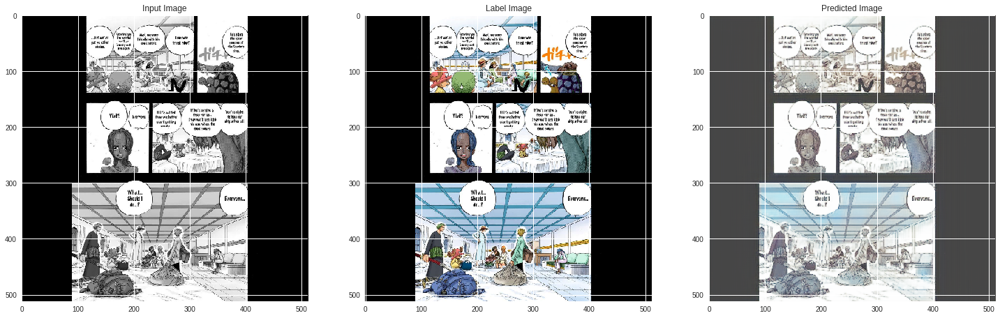

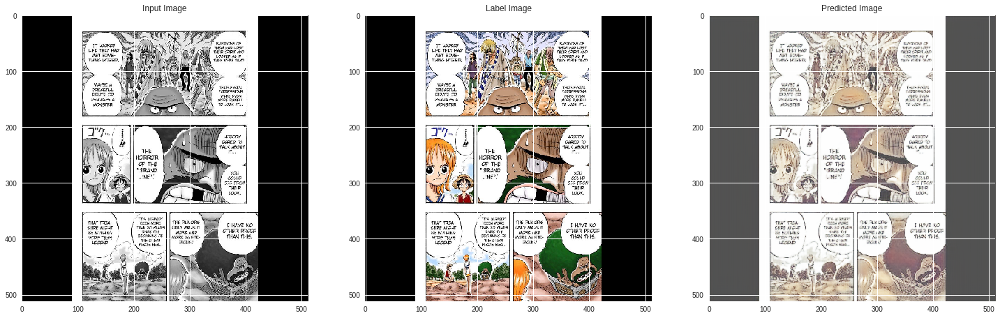

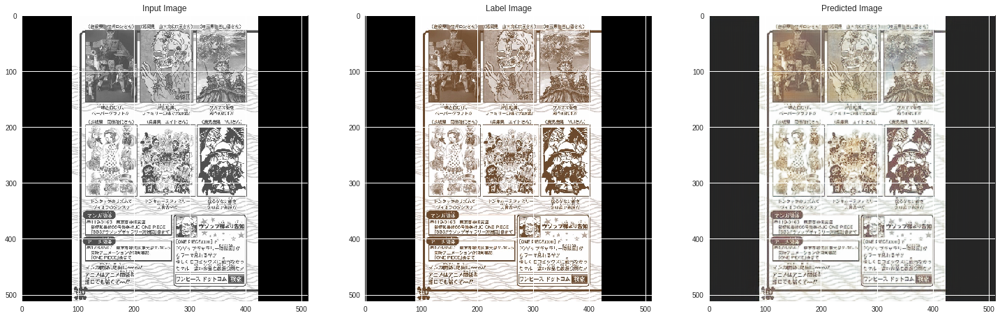

Epoch 1
--------------------
--------------------

Instructions for updating:
Use tf.cast instead.
Epoch 1/1
548/548 [==============================] - 9429s 17s/step - loss: 0.0076 - val_loss: 0.0077


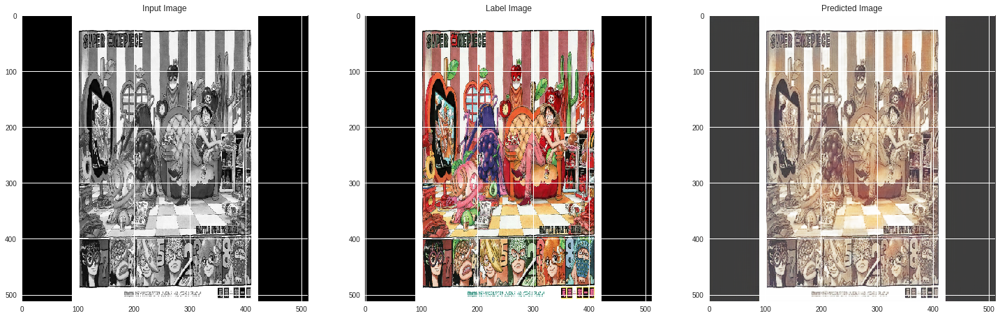

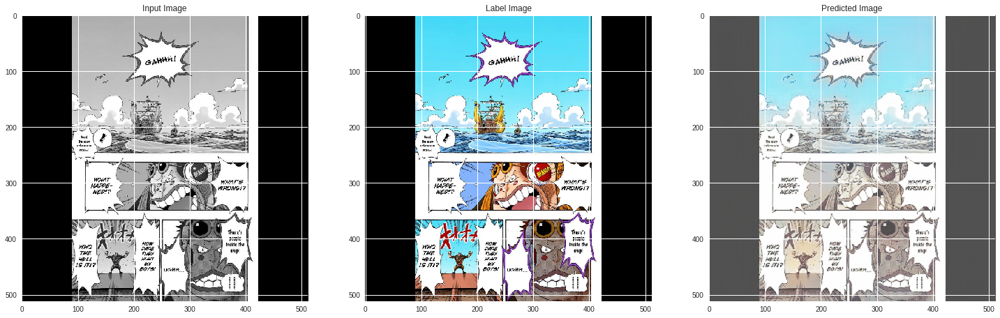

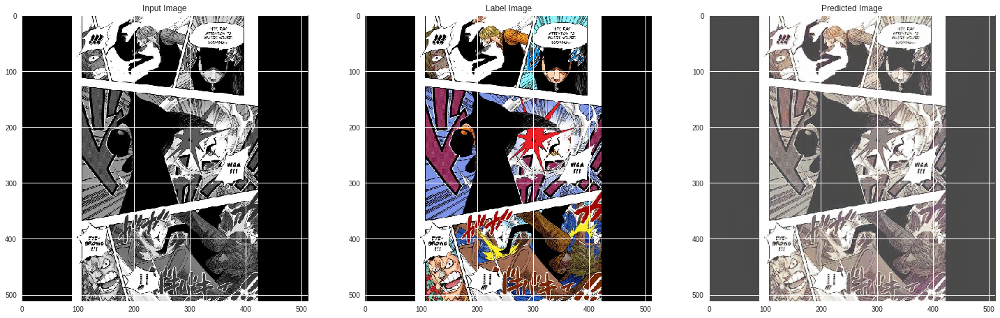

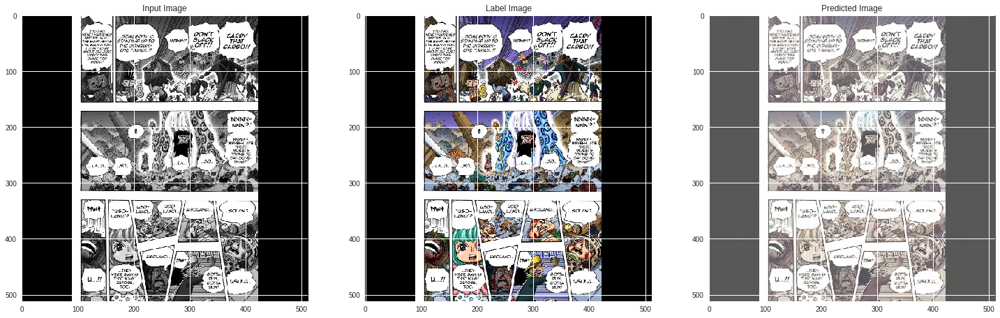

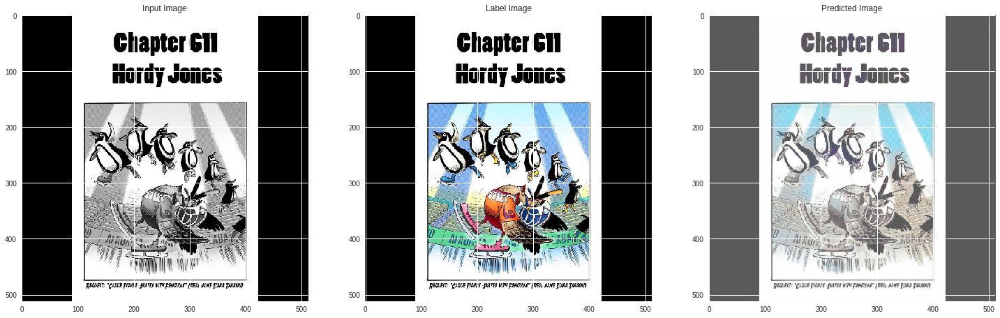



Epoch 2
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1563s 3s/step - loss: 0.0075 - val_loss: 0.0077


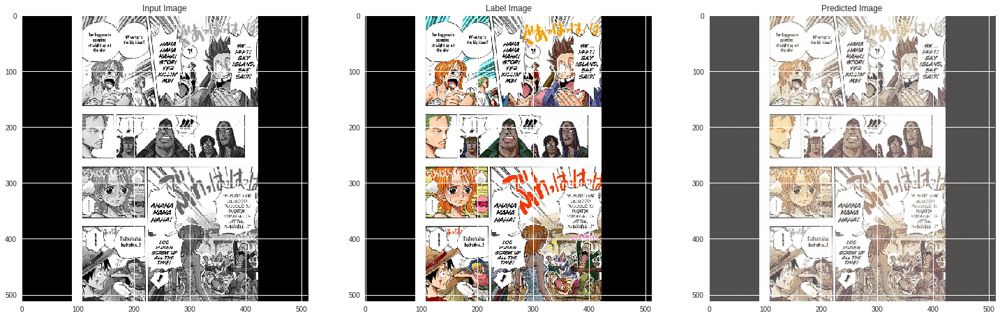

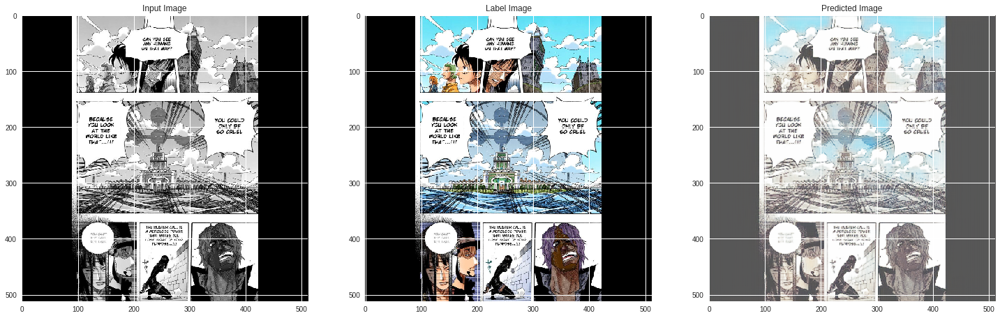

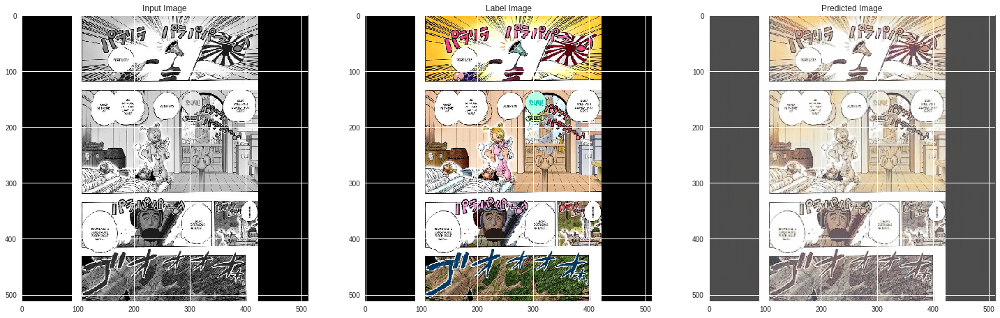

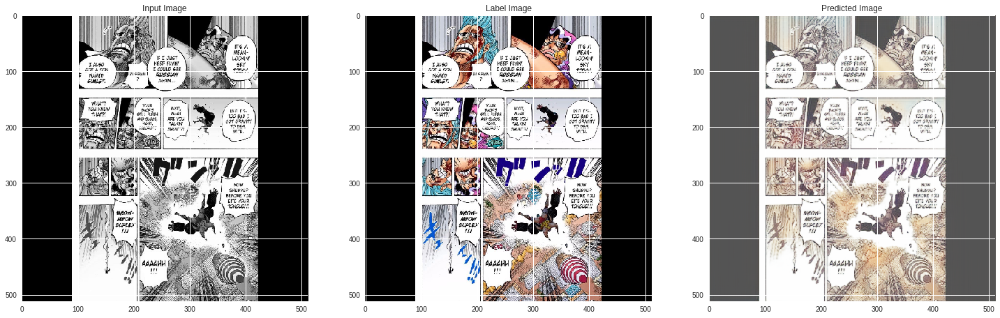

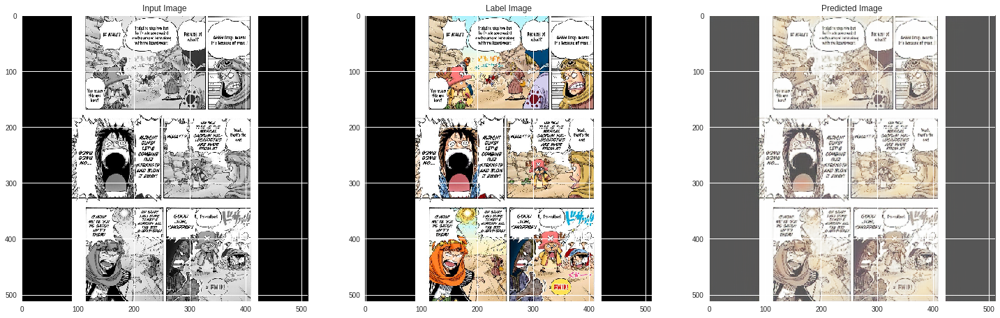



Epoch 3
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1608s 3s/step - loss: 0.0075 - val_loss: 0.0076


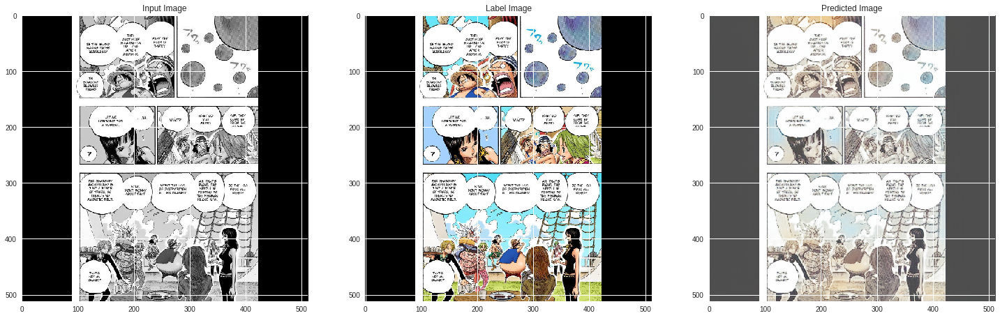

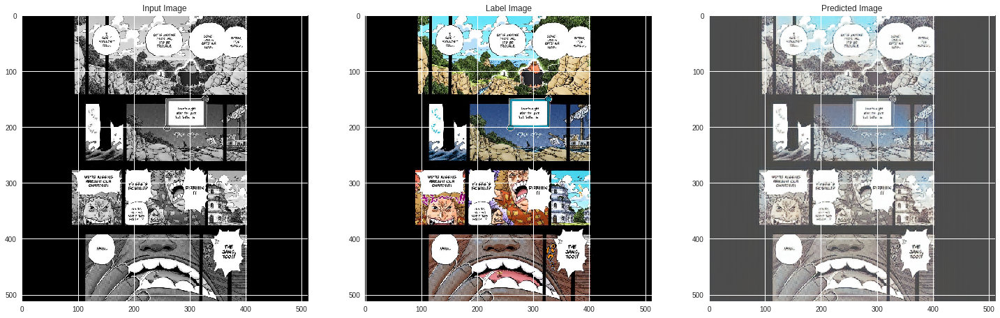

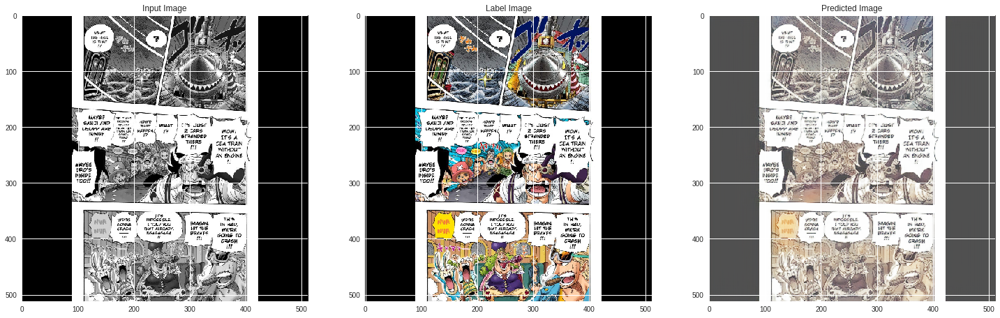

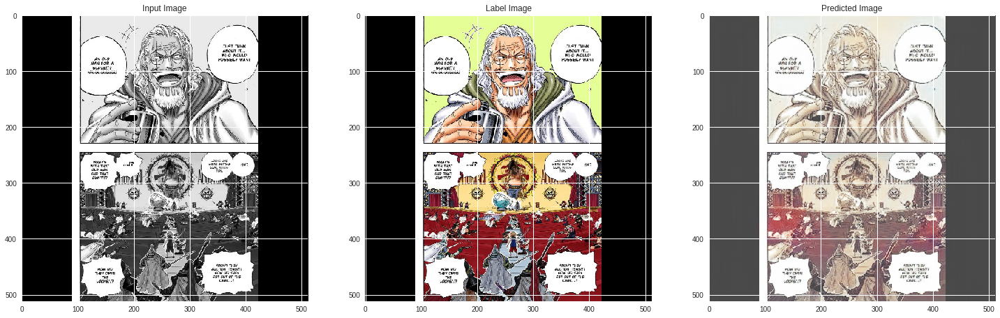

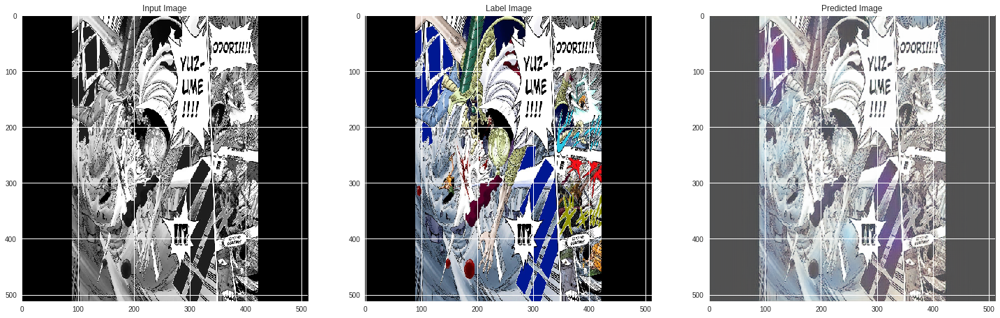



Epoch 4
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1609s 3s/step - loss: 0.0075 - val_loss: 0.0077


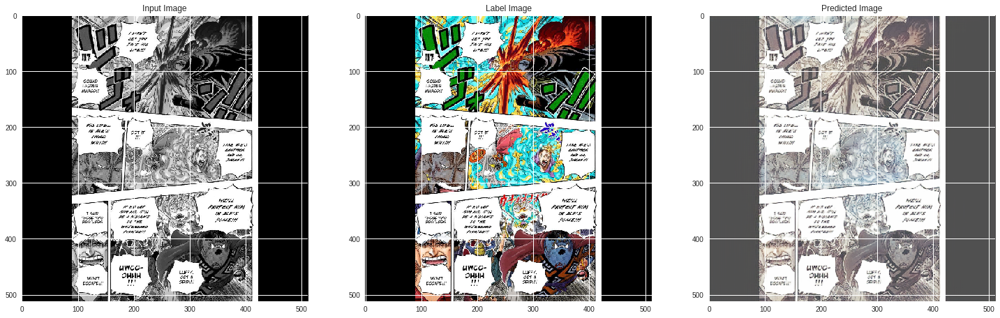

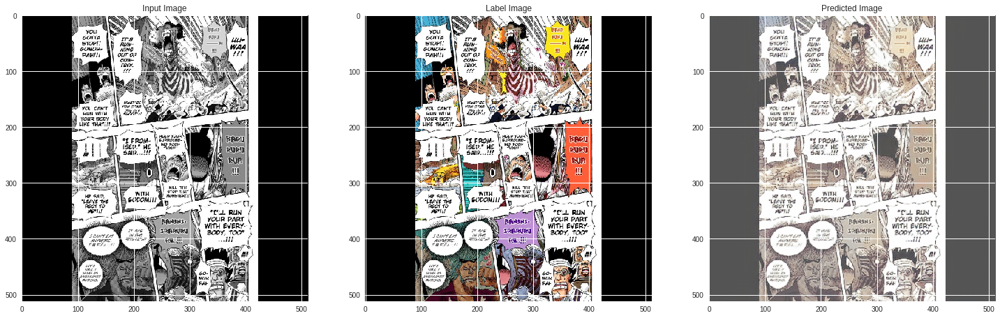

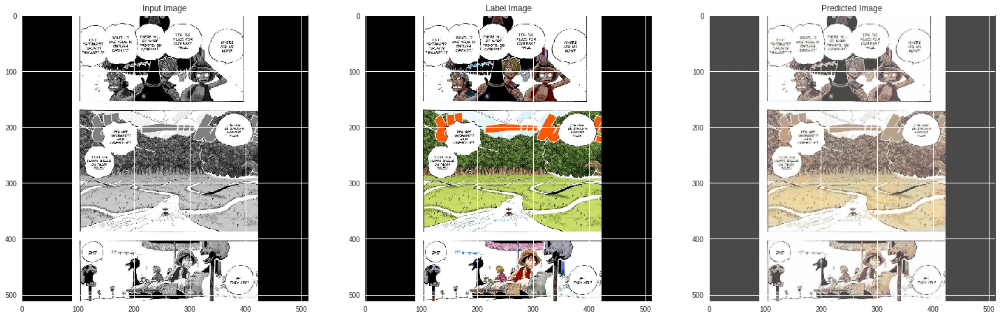

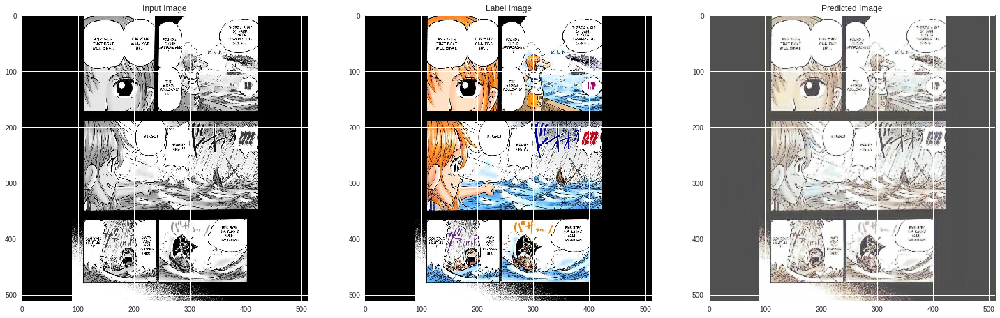

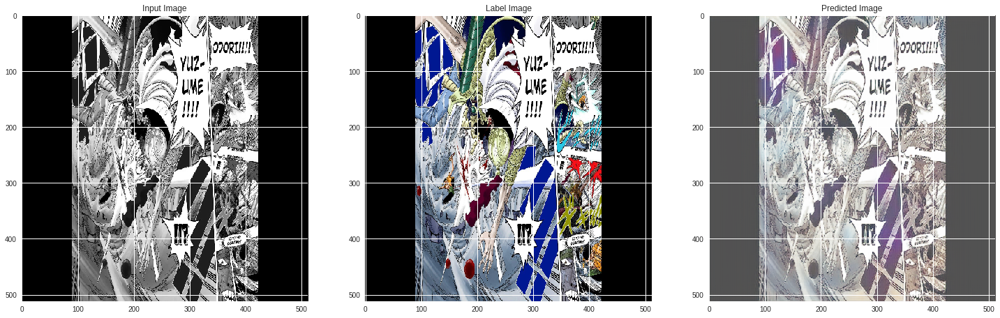



Epoch 5
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1592s 3s/step - loss: 0.0075 - val_loss: 0.0078


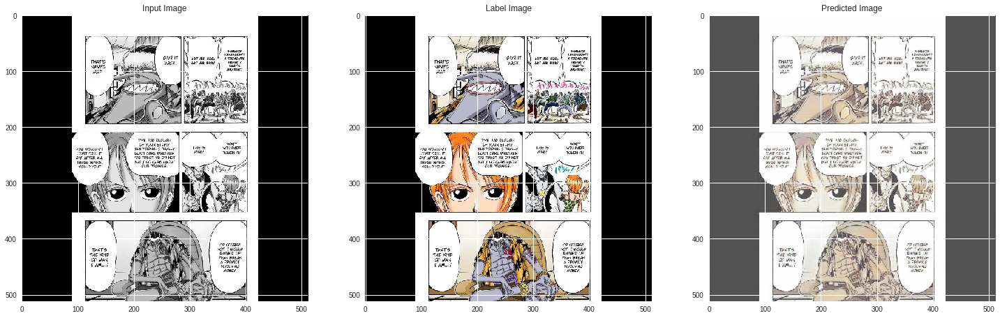

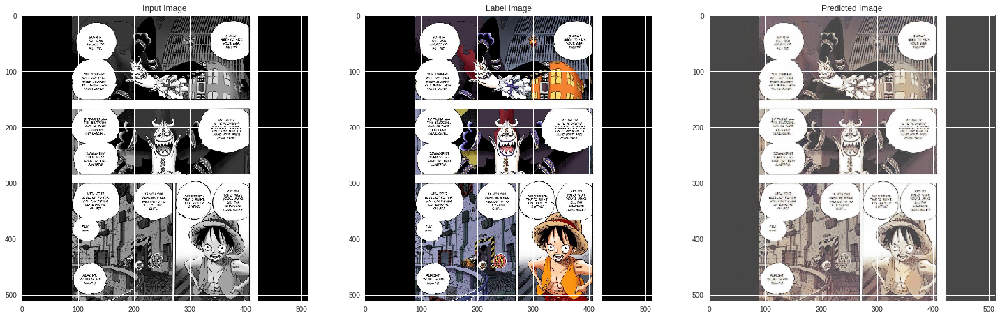

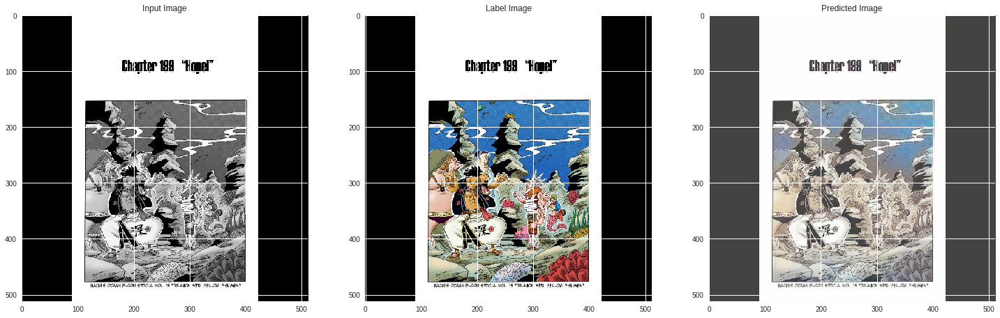

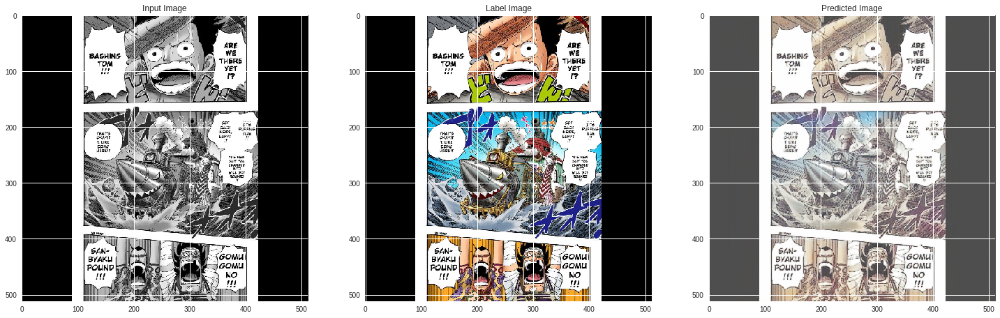

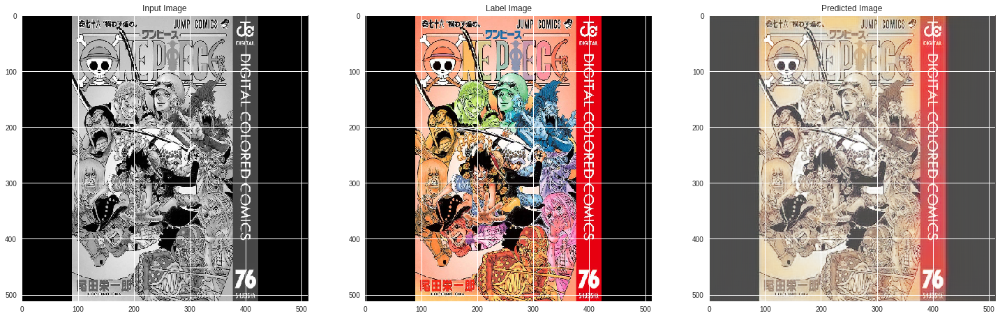



Epoch 6
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1608s 3s/step - loss: 0.0074 - val_loss: 0.0079


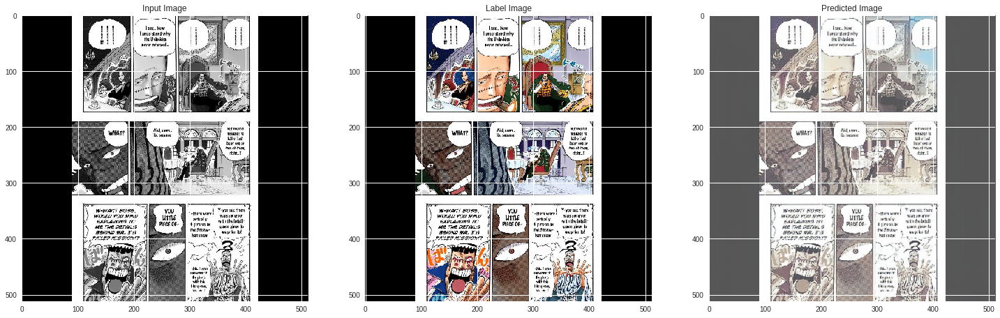

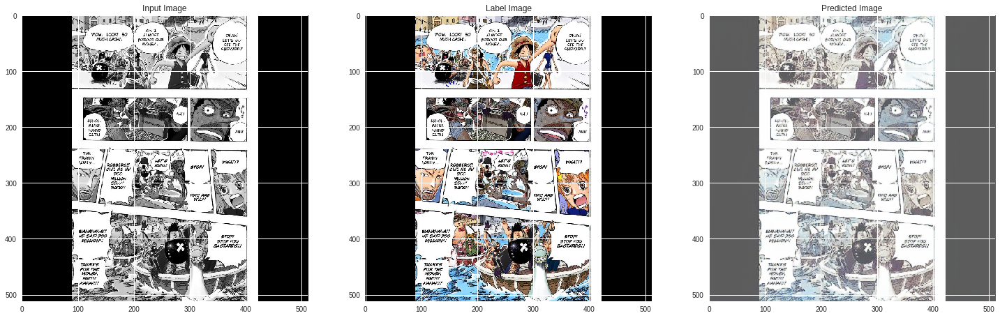

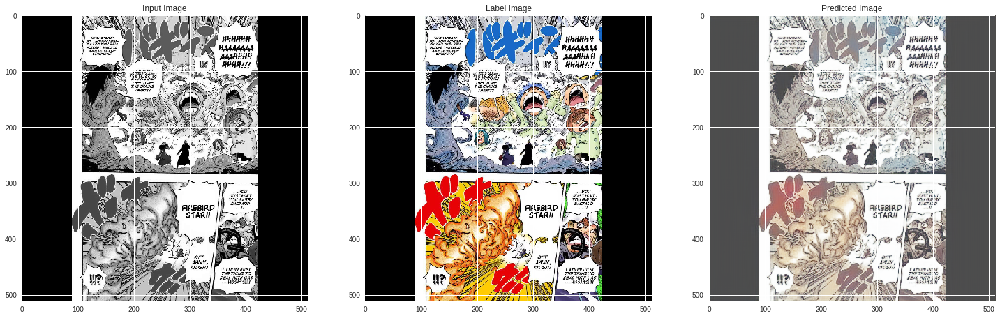

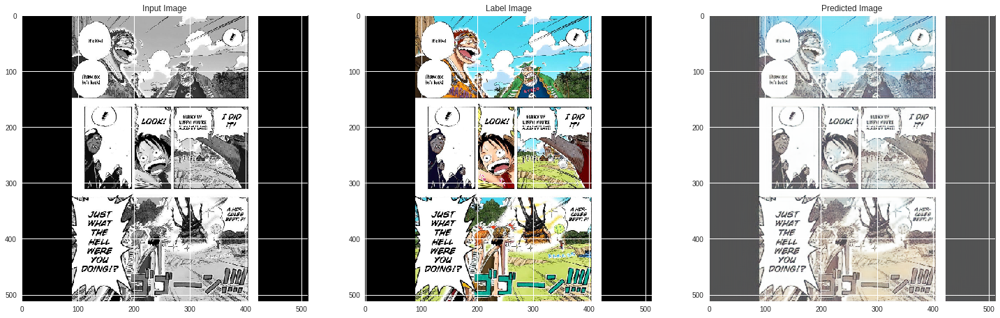

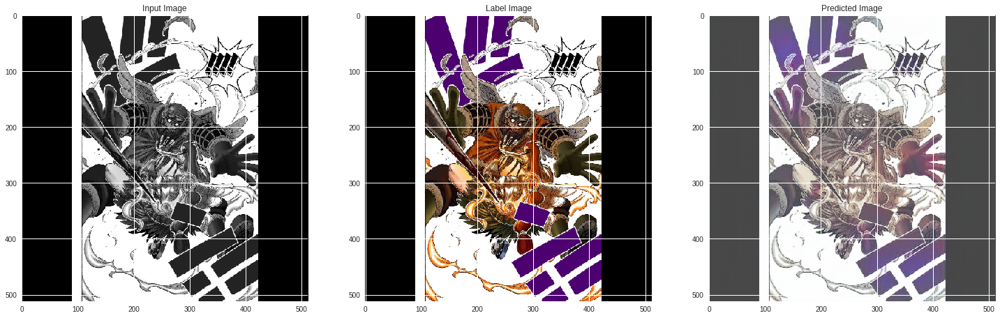



Epoch 7
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1616s 3s/step - loss: 0.0074 - val_loss: 0.0076


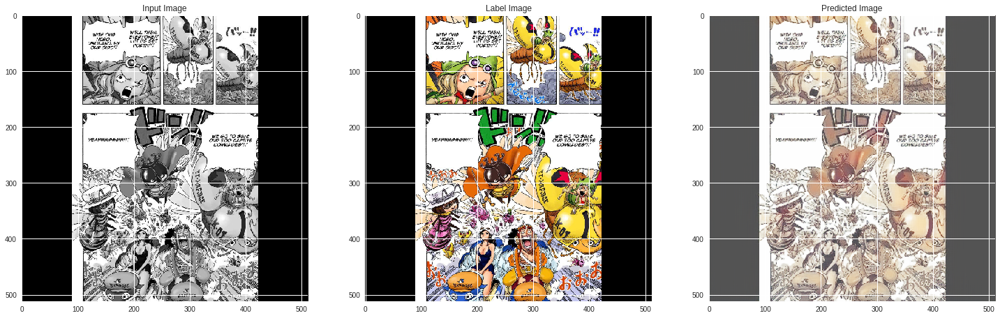

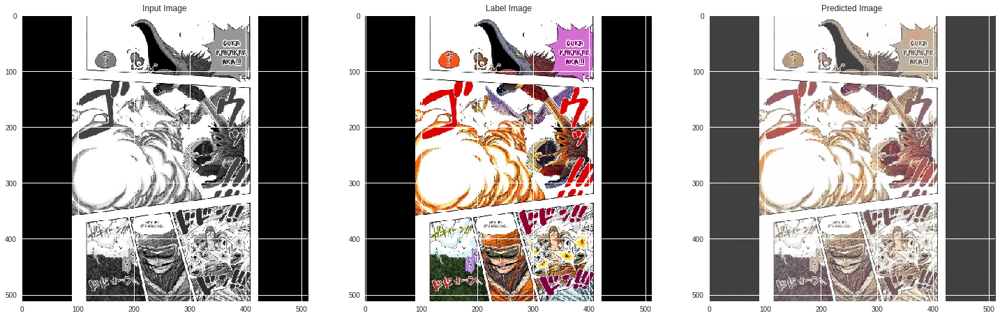

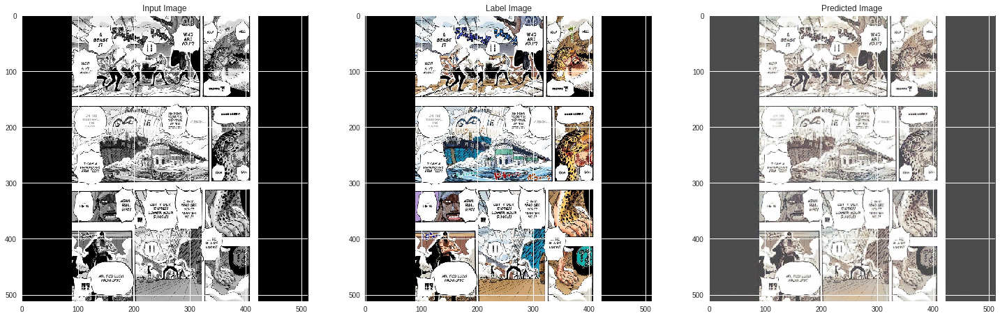

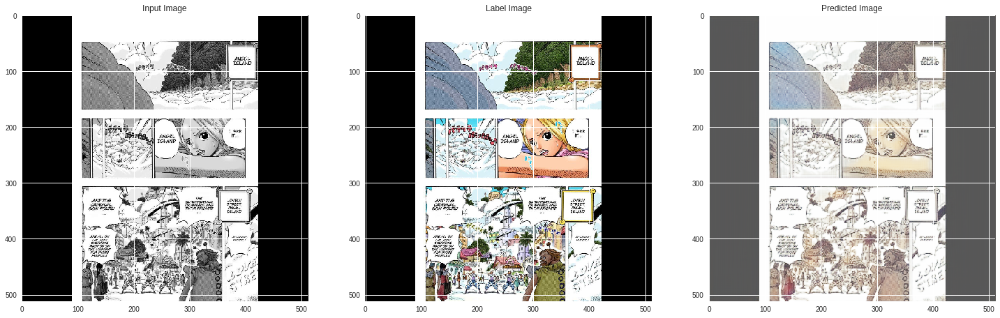

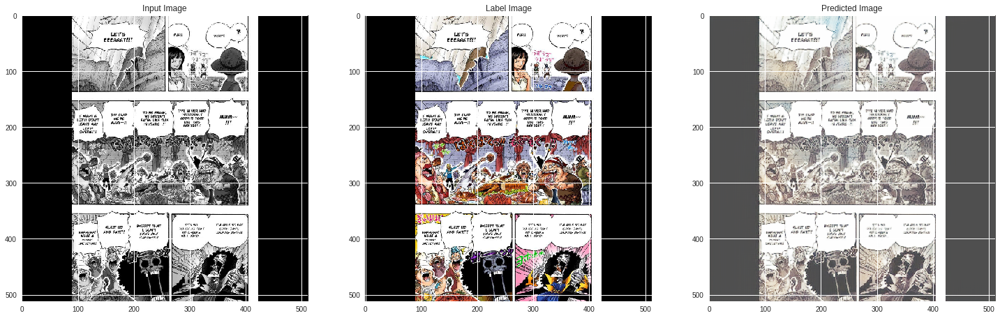



Epoch 8
--------------------
--------------------

Epoch 1/1
548/548 [==============================] - 1570s 3s/step - loss: 0.0074 - val_loss: 0.0079


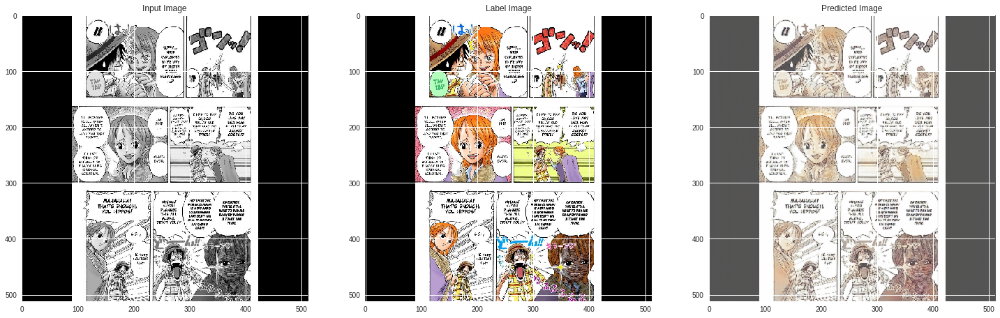

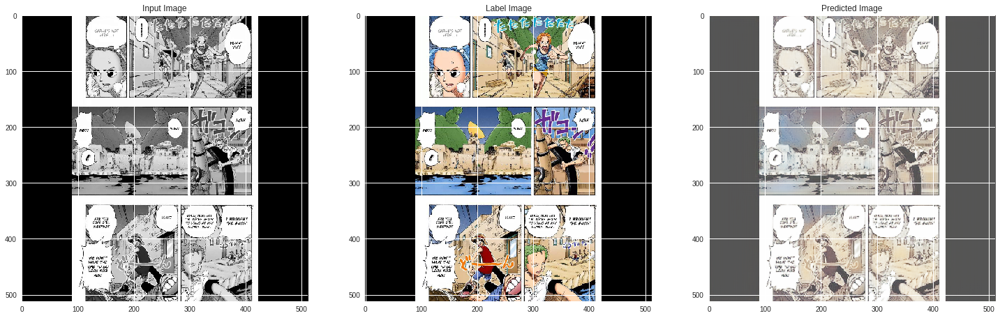

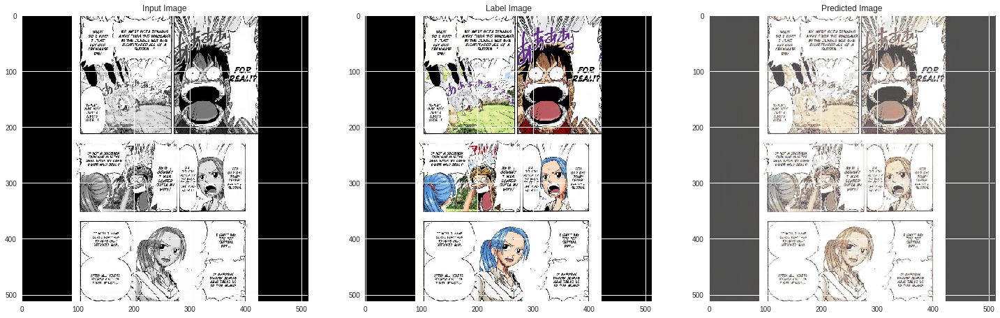

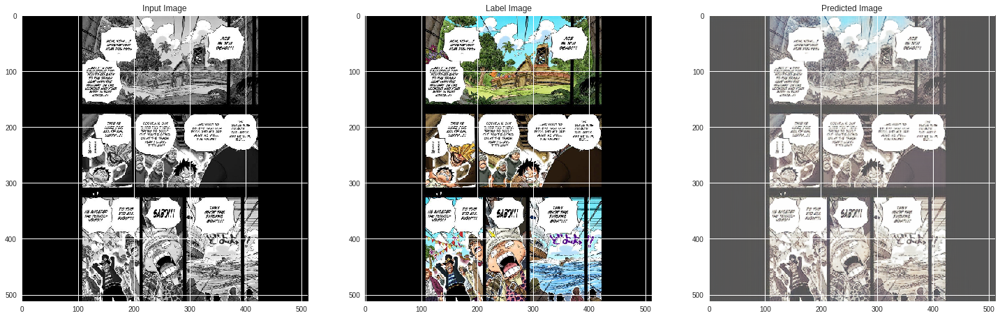

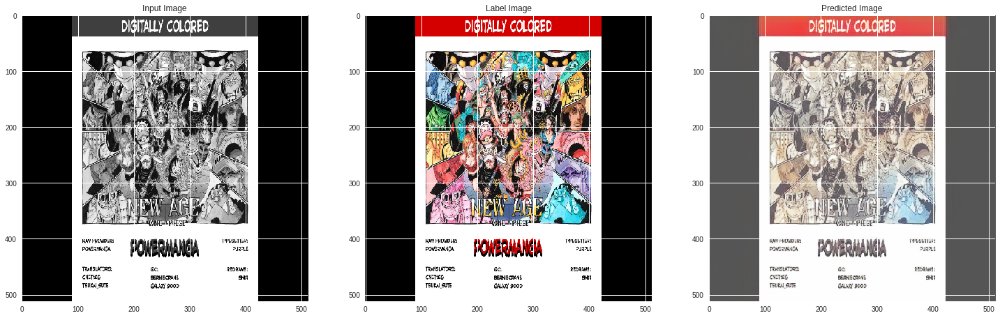



Epoch 9
--------------------
--------------------

Epoch 1/1
  5/548 [..............................] - ETA: 33:12 - loss: 0.0076

In [0]:
best_loss = 0.0088

model.load_weights('model.h5')
visualize_model(model3, valid_fnames, num_files=5)

for epoch in range(100):
  
  print('Epoch', epoch+1)
  print('-' * 20)
  print('-' * 20)
  print()
  history = model.fit_generator(
                              train_generator, 
                              steps_per_epoch=num_train_files//BATCH_SIZE,
                              epochs=1,
                              validation_data=valid_generator,
                              validation_steps=num_valid_files//BATCH_SIZE,
                              use_multiprocessing=True)
  try:
    with open('history.pkl', 'rb') as f:
      history_dict = pickle.load(f)
  except Exception as e:
    history_dict = {}
    
  append_to_history(history)
  
  with open('history.pkl', 'wb') as f:
    pickle.dump(history_dict, f)
  
  visualize_model(model, valid_fnames, num_files=5)
  
  loss = history.history['val_loss'][-1]
  if loss < best_loss:
    best_loss = loss
    model3.save('model.h5')
  
  print()
  print()